In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
%matplotlib inline
import warnings
warnings.filterwarnings("ignore")
import pandas as pd
import numpy as np
import nltk
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.feature_extraction.text import CountVectorizer
from sklearn import metrics
from sklearn.metrics import confusion_matrix, roc_curve, auc
import re
from keras.initializers import RandomNormal
from keras import optimizers
from keras.callbacks import TensorBoard, ModelCheckpoint, EarlyStopping
import pickle
from tqdm import tqdm
import os
import keras

Using TensorFlow backend.


## Assignment : 14

<pre>
1. Preprocess all the Data we have in DonorsChoose <a href='https://drive.google.com/drive/folders/1MIwK7BQMev8f5CbDDVNLPaFGB32pFN60'>Dataset</a> use train.csv
2. Combine 4 essay's into one column named - 'preprocessed_essays'. 
3. After step 2 you have to train 3 types of models as discussed below. 
4. For all the model use <a href='https://scikit-learn.org/stable/modules/model_evaluation.html#roc-metrics'>'auc'</a> as a metric. check <a href='https://datascience.stackexchange.com/a/20192'>this</a> for using auc as a metric 
5. You are free to choose any number of layers/hiddden units but you have to use same type of architectures shown below. 
6. You can use any one of the optimizers and choice of Learning rate and momentum, resources: <a href='http://cs231n.github.io/neural-networks-3/'>cs231n class notes</a>, <a href='https://www.youtube.com/watch?v=hd_KFJ5ktUc'>cs231n class video</a>. 
7. For all the model's use <a href='https://www.youtube.com/watch?v=2U6Jl7oqRkM'>TensorBoard</a> and plot the Metric value and Loss with epoch. While submitting, take a screenshot of plots and include those images in .ipynb notebook and PDF. 
8. Use Categorical Cross Entropy as Loss to minimize.
</pre>

In [0]:
%load_ext tensorboard

### Load Pre-processed data

In [4]:
project_data =pd.read_csv("/content/drive/My Drive/LSTM Assignment/preprocessed_data.csv")
display(project_data.head())
project_data.columns

,school_state,teacher_prefix,project_grade_category,teacher_number_of_previously_posted_projects,project_is_approved,clean_categories,clean_subcategories,essay,price
0,ca,mrs,grades_prek_2,53,1,math_science,appliedsciences health_lifescience,i fortunate enough use fairy tale stem kits cl...,725.05
1,ut,ms,grades_3_5,4,1,specialneeds,specialneeds,imagine 8 9 years old you third grade classroo...,213.03
2,ca,mrs,grades_prek_2,10,1,literacy_language,literacy,having class 24 students comes diverse learner...,329.00
3,ga,mrs,grades_prek_2,2,1,appliedlearning,earlydevelopment,i recently read article giving students choice...,481.04
4,wa,mrs,grades_3_5,2,1,literacy_language,literacy,my students crave challenge eat obstacles brea...,17.74


Index(['school_state', 'teacher_prefix', 'project_grade_category',
       'teacher_number_of_previously_posted_projects', 'project_is_approved',
       'clean_categories', 'clean_subcategories', 'essay', 'price'],
      dtype='object')

### Train-Test split

In [0]:
try:
    y_train = project_data["project_is_approved"]
    project_data.drop(columns=["project_is_approved"],inplace=True)
except:
    pass

x_train , x_test, y_train, y_test = train_test_split(project_data, y_train, stratify=y_train, test_size=0.2, random_state=28)
x_train , x_val, y_train, y_val  = train_test_split(x_train, y_train, stratify=y_train, test_size=0.20, random_state=28)

In [6]:
print("x_train {0} | y_train {1} ".format(x_train.shape , y_train.shape))
print("x_val   {0} | y_val   {1} ".format(x_val.shape , y_val.shape))
print("x_test  {0} | y_test  {1} ".format(x_test.shape , y_test.shape))

x_train (69918, 8) | y_train (69918,) 
x_val   (17480, 8) | y_val   (17480,) 
x_test  (21850, 8) | y_test  (21850,) 


### Data Preprocessing and layers creations

##### Instructions
### 1. Go through this blog, if you have any doubt on using predefined Embedding values in Embedding layer - https://machinelearningmastery.com/use-word-embedding-layers-deep-learning-keras/
### 2. Please go through this link https://keras.io/getting-started/functional-api-guide/ and check the 'Multi-input and multi-output models' then you will get to know how to give multiple inputs. 

#### Essay

In [0]:
"""
https://towardsdatascience.com/text-classification-in-keras-part-2-how-to-use-the-keras-tokenizer-word-representations-fd571674df23
https://machinelearningmastery.com/use-word-embedding-layers-deep-learning-keras/
"""
from keras.preprocessing.text import Tokenizer
#max_words = 10000
tokenizer = keras.preprocessing.text.Tokenizer( lower=True, split=' ', char_level=False, oov_token=None, document_count=0)
tokenizer.fit_on_texts(x_train["essay"])

essay_sequences_train = tokenizer.texts_to_sequences(x_train['essay'])
essay_sequences_val = tokenizer.texts_to_sequences(x_val['essay'])
essay_sequences_test = tokenizer.texts_to_sequences(x_test['essay'])

#######################################################################

"""
https://keras.io/preprocessing/sequence/#pad_sequences
"""
from keras.preprocessing.sequence import pad_sequences
max_length=0;
for essay in x_train["essay"]:    
    temp =len(essay)
    max_length= temp if temp > max_length else max_length

padded_essay_train = pad_sequences(essay_sequences_train, maxlen=max_length, dtype='int32', padding='post', truncating='post', value=0.0)
padded_essay_val = pad_sequences(essay_sequences_val, maxlen=max_length, dtype='int32', padding='post', truncating='post', value=0.0)
padded_essay_test = pad_sequences(essay_sequences_test, maxlen=max_length, dtype='int32', padding='post', truncating='post', value=0.0)

- For LSTM, you can choose your sequence padding methods on your own or you can train your LSTM without padding, there is no restriction on that.

In [8]:
len(tokenizer.word_index)

47291

##### Loading Glove vectors

In [9]:
import pickle
with open("/content/drive/My Drive/LSTM Assignment/glove_vectors","rb") as file:
    embeddings = pickle.load(file)

# vocab_size + 1 since, 0 is not considered by tokenizer.
vocab_size = len(tokenizer.word_index)+1

# create a weight matrix for words in training docs
embedding_matrix = np.zeros((vocab_size, 300))

for word, i in tqdm(tokenizer.word_index.items()):
		embedding_vector = embeddings.get(word)
		if embedding_vector is not None:
				embedding_matrix[i] = embedding_vector

embedding_matrix.shape

100%|██████████| 47291/47291 [00:00<00:00, 392773.99it/s]


(47292, 300)

In [0]:
"""
https://stats.stackexchange.com/questions/270546/how-does-keras-embedding-layer-work
"""
from keras.engine.input_layer import Input
from keras.layers import Embedding, Flatten, LSTM, Dense
from keras.initializers import Constant

essay_input_layer = Input(shape=(max_length,), name="essay_i/p")#, batch_shape=(1000,max_length))
essay_embedding_layer = Embedding(vocab_size, 300, \
                                  embeddings_initializer=Constant(embedding_matrix),
                                  input_length=max_length)(essay_input_layer)
essay_embedding_layer.trainable = False
essay_lstm_layer = LSTM(10, return_sequences=True)(essay_embedding_layer)
# https://github.com/keras-team/keras/issues/7403
essay_flatten = Flatten()(essay_lstm_layer)

In [11]:
max_length, essay_input_layer.shape , essay_embedding_layer.shape , essay_lstm_layer.shape , essay_flatten.shape

(2527,
 TensorShape([None, 2527]),
 TensorShape([None, 2527, 300]),
 TensorShape([None, 2527, 10]),
 TensorShape([None, None]))

#### school_state

In [12]:
"""
Using LabelEncoder and create embeddings on categorical data. 
Also dealing with unseen data, during le.transform()
https://medium.com/@satnalikamayank12/on-learning-embeddings-for-categorical-data-using-keras-165ff2773fc9
https://stackoverflow.com/questions/21057621/sklearn-labelencoder-with-never-seen-before-values
"""

# school_state - LabelEncoder
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
school_state_x_train = le.fit_transform(x_train["school_state"])
school_state_x_val = le.transform(x_val["school_state"])
school_state_x_test = le.transform(x_test["school_state"])
print(le.classes_)
# we don't have any unseen data in val, test data.

# school_state 
school_state_vocab_size = x_train["school_state"].nunique() # gives unique values count
school_state_output_dim = int(min(np.ceil((school_state_vocab_size)/2), 50 ))  # Half of the input_dim i.e vocalbulary_size
school_state_input_length = 1 # Max num of words for one row, here every row has only single value.

#layers
school_state_input_layer = Input(shape=(school_state_input_length,), name="school_state")
school_state_embedding_layer = Embedding(school_state_vocab_size+1, school_state_output_dim,\
                                         embeddings_initializer='he_normal',
                                         input_length=school_state_input_length)(school_state_input_layer)

school_state_flatten = Flatten()(school_state_embedding_layer)

print("school_state Layers created")
print(school_state_x_train.shape, "\n", school_state_x_val.shape, "\n", school_state_x_test.shape)

['ak' 'al' 'ar' 'az' 'ca' 'co' 'ct' 'dc' 'de' 'fl' 'ga' 'hi' 'ia' 'id'
 'il' 'in' 'ks' 'ky' 'la' 'ma' 'md' 'me' 'mi' 'mn' 'mo' 'ms' 'mt' 'nc'
 'nd' 'ne' 'nh' 'nj' 'nm' 'nv' 'ny' 'oh' 'ok' 'or' 'pa' 'ri' 'sc' 'sd'
 'tn' 'tx' 'ut' 'va' 'vt' 'wa' 'wi' 'wv' 'wy']
school_state Layers created
(69918,) 
 (17480,) 
 (21850,)


In [13]:
school_state_input_layer.shape , school_state_embedding_layer.shape , school_state_flatten.shape 

(TensorShape([None, 1]), TensorShape([None, 1, 26]), TensorShape([None, None]))

#### teacher_prefix

In [14]:
"""
Using LabelEncoder and create embeddings on categorical data. 
Also dealing with unseen data, during le.transform()
https://medium.com/@satnalikamayank12/on-learning-embeddings-for-categorical-data-using-keras-165ff2773fc9
https://stackoverflow.com/questions/21057621/sklearn-labelencoder-with-never-seen-before-values
"""

# teacher_prefix - LabelEncoder
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
teacher_prefix_x_train = le.fit_transform(x_train["teacher_prefix"])
teacher_prefix_x_val = le.transform(x_val["teacher_prefix"])
teacher_prefix_x_test = le.transform(x_test["teacher_prefix"])
print(le.classes_)
# we don't have any unseen data in val, test data

# teacher_prefix
teacher_prefix_vocab_size = x_train["teacher_prefix"].nunique() # gives unique values count
teacher_prefix_output_dim = int(min(np.ceil((teacher_prefix_vocab_size)/2), 50 ))  # Half of the input_dim i.e vocalbulary_size
teacher_prefix_input_length = 1 # Max num of words for one row, here every row has only single value.

# layers
teacher_prefix_input_layer = Input(shape=(teacher_prefix_input_length,), name="teacher_prefix_i/p")
teacher_prefix_embedding_layer = Embedding(teacher_prefix_vocab_size+1, teacher_prefix_output_dim,\
                                           embeddings_initializer="he_normal",\
                                         input_length=teacher_prefix_input_length)(teacher_prefix_input_layer)

teacher_prefix_flatten = Flatten()(teacher_prefix_embedding_layer)

print("teacher_prefix Layers created")
print(teacher_prefix_x_train.shape, "\n", teacher_prefix_x_val.shape, "\n", teacher_prefix_x_test.shape)

['dr' 'mr' 'mrs' 'ms' 'teacher']
teacher_prefix Layers created
(69918,) 
 (17480,) 
 (21850,)


#### project_grade_category

In [15]:
"""
Use LabelEncoder & then create embeddings on categorical data. 
Also dealing with unseen data, during le.transform()
https://medium.com/@satnalikamayank12/on-learning-embeddings-for-categorical-data-using-keras-165ff2773fc9
https://stackoverflow.com/questions/21057621/sklearn-labelencoder-with-never-seen-before-values
"""

# project_grade_category - LabelEncoder
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
grade_x_train = le.fit_transform(x_train["project_grade_category"])
grade_x_val = le.transform(x_val["project_grade_category"])
grade_x_test = le.transform(x_test["project_grade_category"])
print(le.classes_)
# we don't have any unseen data in val, test data

# project_grade_category
grade_vocab_size = x_train["project_grade_category"].nunique()  # gives unique values count 
grade_output_dim = int(min(np.ceil((grade_vocab_size)/2), 50 ))  # Half of the input_dim i.e vocalbulary_size
grade_input_length = 1 # Max num of words for one row, here every row has only single value.

# layers
grade_input_layer = Input(shape=(grade_input_length,), name="grade_i/p")
grade_embedding_layer = Embedding(grade_vocab_size+1, grade_output_dim,\
                                  embeddings_initializer="he_normal",\
                                  input_length=grade_input_length)(grade_input_layer)

grade_flatten = Flatten()(grade_embedding_layer)

print("project_grade_category Layers created")
print(grade_x_train.shape, "\n", grade_x_val.shape, "\n", grade_x_test.shape)

['grades_3_5' 'grades_6_8' 'grades_9_12' 'grades_prek_2']
project_grade_category Layers created
(69918,) 
 (17480,) 
 (21850,)


#### clean_categories

```
clean_categories have more than one value in each row, which is seperated by space.
So, LabelEncoding may cosider multiple values in a row as a unique token.
Therefore, use OneHotEncoding (or) Do tokenizer-sequences, padding and then pass it to Embedding Layer

```

In [0]:
from sklearn.feature_extraction.text import CountVectorizer


def vectorize_cat_data(x_train, x_val, x_test, col_name): 
    #filling nan with NAN
    x_train[col_name] = x_train[col_name].fillna('NAN')
    x_val[col_name] = x_val[col_name].fillna('NAN')
    x_test[col_name] = x_test[col_name].fillna('NAN')
    
    vectorizer= CountVectorizer(lowercase=False, binary=True)
    vectorizer.fit(x_train[col_name].values)

    col_name_one_hot = vectorizer.transform(x_train[col_name].values)
    # store the feature names of all categorical columns
    print(vectorizer.get_feature_names())
    print("Shape of matrix after one hot encoding ",col_name_one_hot.shape,"\n")

    return vectorizer , col_name_one_hot, vectorizer.transform(x_val[col_name].values), vectorizer.transform(x_test[col_name].values)


In [17]:
# OHE clean_categories
vectorizer, categories_x_train, categories_x_val, categories_x_test = \
                                                    vectorize_cat_data(x_train, x_val, x_test, 'clean_categories')

# clean_categories - Layer variables/parameters
categories_vocab_size = len(vectorizer.get_feature_names())  # gives unique values count 
categories_output_dim = int(min(np.ceil((categories_vocab_size)/2), 50 ))  # Half of the input_dim i.e vocalbulary_size
categories_input_length = categories_vocab_size # Max num of words for one row, since ts ohe, it has 9 shaped <...> vector

# layers
categories_input_layer = Input(shape=(categories_input_length,), name="categories_i/p")
categories_embedding_layer = Embedding(categories_vocab_size, categories_output_dim, \
                                       embeddings_initializer="he_normal",\
                                         input_length=categories_input_length)(categories_input_layer)

categories_flatten = Flatten()(categories_embedding_layer)

print("clean_categories Layers created")
print(categories_x_train.shape, "\n", categories_x_val.shape, "\n", categories_x_test.shape)

['appliedlearning', 'care_hunger', 'health_sports', 'history_civics', 'literacy_language', 'math_science', 'music_arts', 'specialneeds', 'warmth']
Shape of matrix after one hot encoding  (69918, 9) 

clean_categories Layers created
(69918, 9) 
 (17480, 9) 
 (21850, 9)


In [18]:
categories_input_layer.shape , categories_embedding_layer.shape , categories_flatten.shape 

(TensorShape([None, 9]), TensorShape([None, 9, 5]), TensorShape([None, None]))

#### clean_subcategories

```
clean_subcategories have more than one value in each row, which is seperated by space.
So, LabelEncoding may cosider multiple values in a row as a unique token.
Therefore, use OneHotEncoding (or) Do tokenizer-sequences, padding and then pass it to Embedding Layer

```

In [19]:
# OHE clean_subcategories
vectorizer, subcategories_x_train, subcategories_x_val, subcategories_x_test = \
                                                    vectorize_cat_data(x_train, x_val, x_test, 'clean_subcategories')

# clean_subcategories - Layer variables/parameters
subcategories_vocab_size = len(vectorizer.get_feature_names())  # gives unique values count 
subcategories_output_dim = int(min(np.ceil((subcategories_vocab_size)/2), 50 ))  # Half of the input_dim i.e vocalbulary_size
subcategories_input_length = subcategories_vocab_size # Max num of words for one row, here every row has only single value.

# layers
subcategories_input_layer = Input(shape=(subcategories_input_length,), name="subcategories_i/p")
subcategories_embedding_layer = Embedding(subcategories_vocab_size, subcategories_output_dim, \
                                          embeddings_initializer="glorot_normal",\
                                         input_length=subcategories_input_length)(subcategories_input_layer)

subcategories_flatten = Flatten()(subcategories_embedding_layer)

print("clean_subcategories Layers created")
print(subcategories_x_train.shape, "\n", subcategories_x_val.shape, "\n", subcategories_x_test.shape)

['appliedsciences', 'care_hunger', 'charactereducation', 'civics_government', 'college_careerprep', 'communityservice', 'earlydevelopment', 'economics', 'environmentalscience', 'esl', 'extracurricular', 'financialliteracy', 'foreignlanguages', 'gym_fitness', 'health_lifescience', 'health_wellness', 'history_geography', 'literacy', 'literature_writing', 'mathematics', 'music', 'nutritioneducation', 'other', 'parentinvolvement', 'performingarts', 'socialsciences', 'specialneeds', 'teamsports', 'visualarts', 'warmth']
Shape of matrix after one hot encoding  (69918, 30) 

clean_subcategories Layers created
(69918, 30) 
 (17480, 30) 
 (21850, 30)


#### Numerical_features

In [0]:
# # essay_length
# x_train["essay_length"] = x_train["essay"].apply(len)
# x_val["essay_length"] = x_val["essay"].apply(len)
# x_test["essay_length"] = x_test["essay"].apply(len)

In [0]:
# standardization sklearn: https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.StandardScaler.html

from sklearn.preprocessing import StandardScaler, Normalizer
#This function return the normalized data.
def standardize_data(x_train, x_val, x_test, column):   
    scalar = StandardScaler()
    scalar.fit(x_train[column].values.reshape(-1,1))
    std_scalar_x_train = scalar.transform(x_train[column].values.reshape(-1,1))
    std_scalar_x_val = scalar.transform(x_val[column].values.reshape(-1,1))
    std_scalar_x_test = scalar.transform(x_test[column].values.reshape(-1,1))
    return std_scalar_x_train, std_scalar_x_val, std_scalar_x_test

In [0]:
price_x_train, price_x_val, price_x_test = \
                                        standardize_data(x_train, x_val, x_test, "price")

teacher_prev_projects_x_train, teacher_prev_projects_x_val, teacher_prev_projects_x_test = \
                                        standardize_data(x_train, x_val, x_test, "teacher_number_of_previously_posted_projects")

numerical_features_x_train = np.hstack((price_x_train, teacher_prev_projects_x_train))
numerical_features_x_val = np.hstack((price_x_val, teacher_prev_projects_x_val))
numerical_features_x_test = np.hstack((price_x_test, teacher_prev_projects_x_test))

In [0]:
# Defining layers
numerical_input_layer = Input(shape=(2,), name="numerical_layer")
numerical_dense = Dense(10, activation='relu')(numerical_input_layer)

### Model-1

Build and Train deep neural network as shown below

<img src='https://i.imgur.com/w395Yk9.png'>
ref: https://i.imgur.com/w395Yk9.png

- __Input_seq_total_text_data__ --- You have to give Total text data columns. After this use the Embedding layer to get word vectors. Use given predefined glove word vectors, don't train any word vectors. After this use LSTM and get the LSTM output and Flatten that output. 
- __Input_school_state__ --- Give 'school_state' column as input to embedding layer and Train the Keras Embedding layer. 
- __Project_grade_category__  --- Give 'project_grade_category' column as input to embedding layer and Train the Keras Embedding layer.
- __Input_clean_categories__ --- Give 'input_clean_categories' column as input to embedding layer and Train the Keras Embedding layer.
- __Input_clean_subcategories__ --- Give 'input_clean_subcategories' column as input to embedding layer and Train the Keras Embedding layer.
- __Input_clean_subcategories__ --- Give 'input_teacher_prefix' column as input to embedding layer and Train the Keras Embedding layer.
- __Input_remaining_teacher_number_of_previously_posted_projects._resource_summary_contains_numerical_digits._price._quantity__ ---concatenate remaining columns and add a Dense layer after that. 



In [0]:
from keras.layers import concatenate, Dropout, BatchNormalization, Activation

concatenate_layer = concatenate([essay_flatten, school_state_flatten, grade_flatten, categories_flatten,
                     subcategories_flatten, teacher_prefix_flatten, numerical_dense])

In [0]:
dense_layer0 = Dense(64, activation="relu")(concatenate_layer)

BN_layer0 = BatchNormalization()(dense_layer0)

dropout_layer0 = Dropout(0.5)(BN_layer0)

dense_layer1 = Dense(32, activation="relu")(dropout_layer0)

BN_layer1 = BatchNormalization()(dense_layer1)

dropout_layer1 = Dropout(0.40)(BN_layer1)

dense_layer2 = Dense(16, activation="relu")(dropout_layer1)

final_layer = Dense(1, activation='sigmoid', name="o/p_layer")(dense_layer2)

In [0]:
from keras.models import Model
model1= Model(inputs=[essay_input_layer, school_state_input_layer, teacher_prefix_input_layer, grade_input_layer,
                      categories_input_layer, subcategories_input_layer, numerical_input_layer], 
              outputs=[final_layer])

In [0]:
# https://stackoverflow.com/questions/41032551/how-to-compute-receiving-operating-characteristic-roc-and-auc-in-keras
import tensorflow as tf
from sklearn.metrics import roc_auc_score

def aucroc(y_true, y_pred):
    return tf.py_function(roc_auc_score, (y_true, y_pred), tf.double)

In [0]:
#model1.layers

In [29]:
from keras.optimizers import Adam
adam_optimizer = Adam(learning_rate=0.0005, beta_1=0.9, beta_2=0.999)
model1.compile(optimizer=adam_optimizer, loss='binary_crossentropy', metrics = [aucroc]) 
model1.summary()

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
essay_i/p (InputLayer)          (None, 2527)         0                                            
__________________________________________________________________________________________________
embedding_1 (Embedding)         (None, 2527, 300)    14187600    essay_i/p[0][0]                  
__________________________________________________________________________________________________
school_state (InputLayer)       (None, 1)            0                                            
__________________________________________________________________________________________________
grade_i/p (InputLayer)          (None, 1)            0                                            
____________________________________________________________________________________________

In [0]:
input_train = [  padded_essay_train, 
                 school_state_x_train,
                 grade_x_train,
                 teacher_prefix_x_train,
                 categories_x_train,
                 subcategories_x_train,
                 numerical_features_x_train,
                ]

input_val = [  padded_essay_val, 
              school_state_x_val,
              grade_x_val,
              teacher_prefix_x_val,
              categories_x_val,
              subcategories_x_val,
              numerical_features_x_val,
            ]

input_test = [  padded_essay_test, 
                school_state_x_test,
                grade_x_test,
                teacher_prefix_x_test,
                categories_x_test,
                subcategories_x_test,
                numerical_features_x_test,
                ]              

In [31]:
for i in input_train:
  print(i.shape)

y_train.shape, y_val.shape, y_test.shape

(69918, 2527)
(69918,)
(69918,)
(69918,)
(69918, 9)
(69918, 30)
(69918, 2)


((69918,), (17480,), (21850,))

In [0]:
#@title
# test_input_length = 10000

# input_train = [  np.array(padded_essay_train)[:test_input_length], 
#                  np.array(school_state_x_train)[:test_input_length],
#                  np.array(grade_x_train)[:test_input_length],
#                  np.array(teacher_prefix_x_train)[:test_input_length],
#                  np.array(categories_x_train)[:test_input_length],
#                  np.array(subcategories_x_train)[:test_input_length],
#                  np.array(numerical_features_x_train)[:test_input_length],
#                 ]


# input_cv = [  np.array(padded_essay_val)[:test_input_length], 
#                  np.array(school_state_x_val)[:test_input_length],
#                  np.array(grade_x_val)[:test_input_length],
#                  np.array(teacher_prefix_x_val)[:test_input_length],
#                  np.array(categories_x_val)[:test_input_length],
#                  np.array(subcategories_x_val)[:test_input_length],
#                  np.array(numerical_features_x_val)[:test_input_length],
#                 ]

# input_test = [  np.array(padded_essay_test)[:test_input_length], 
#                  np.array(school_state_x_test)[:test_input_length],
#                  np.array(grade_x_test)[:test_input_length],
#                  np.array(teacher_prefix_x_test)[:test_input_length],
#                  np.array(categories_x_test)[:test_input_length],
#                  np.array(subcategories_x_test)[:test_input_length],
#                  np.array(numerical_features_x_test)[:test_input_length],
#                 ]              

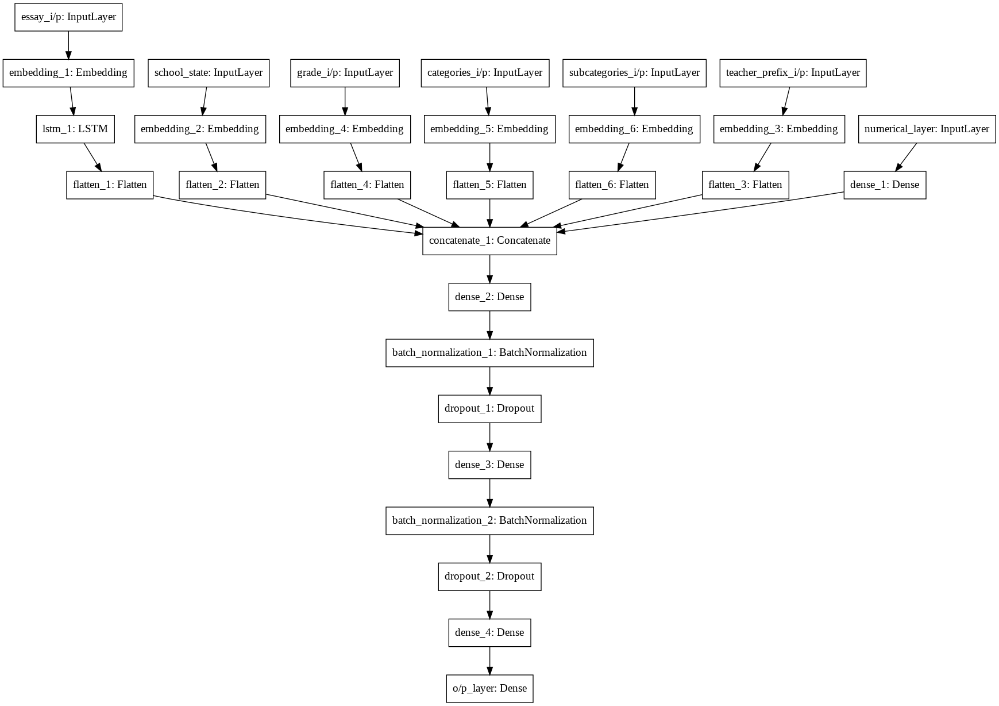

In [33]:
from keras.utils import plot_model
plot_model(model1, to_file='model1.png')

In [0]:
batch_size=400
epochs = 10

In [0]:
# https://keras.io/callbacks/

tensorboard_callback = TensorBoard(log_dir='./logs', histogram_freq=1, batch_size=batch_size, write_graph=True, 
                           write_grads=False, write_images=True, embeddings_freq=0, update_freq='epoch')

filepath="Model1-weights-improvement-{epoch:02d}-{val_loss:.2f}.hdf5"
# I'm saving only best weights among the all epochs
model_checkpoint_callback = ModelCheckpoint(filepath, monitor='val_loss', verbose=0, 
                                          save_best_only=True, save_weights_only=False, mode='auto', period=1)
early_stopping_callback =  EarlyStopping(monitor="val_loss", min_delta=0, patience=3, verbose=0, mode="auto", baseline=None)

In [36]:
%tensorboard --logdir logs

<IPython.core.display.Javascript object>

In [37]:
history1 = model1.fit(input_train, y_train ,batch_size=batch_size,
                        epochs=epochs, validation_data=(input_val, y_val),
                      callbacks=[tensorboard_callback, model_checkpoint_callback])

Train on 69918 samples, validate on 17480 samples
Epoch 1/10
69918/69918 [==============================] - 1467s 21ms/step - loss: 0.5116 - aucroc: 0.5343 - val_loss: 0.4392 - val_aucroc: 0.6292
Epoch 2/10
69918/69918 [==============================] - 1460s 21ms/step - loss: 0.4111 - aucroc: 0.6640 - val_loss: 0.3813 - val_aucroc: 0.7319
Epoch 3/10
69918/69918 [==============================] - 1462s 21ms/step - loss: 0.3797 - aucroc: 0.7346 - val_loss: 0.3739 - val_aucroc: 0.7453
Epoch 4/10
69918/69918 [==============================] - 1480s 21ms/step - loss: 0.3604 - aucroc: 0.7695 - val_loss: 1.4462 - val_aucroc: 0.7289
Epoch 5/10
69918/69918 [==============================] - 1462s 21ms/step - loss: 0.3392 - aucroc: 0.8030 - val_loss: 0.7951 - val_aucroc: 0.7281
Epoch 6/10
22400/69918 [========>.....................] - ETA: 16:05 - loss: 0.3080 - aucroc: 0.8446

KeyboardInterrupt: ignored

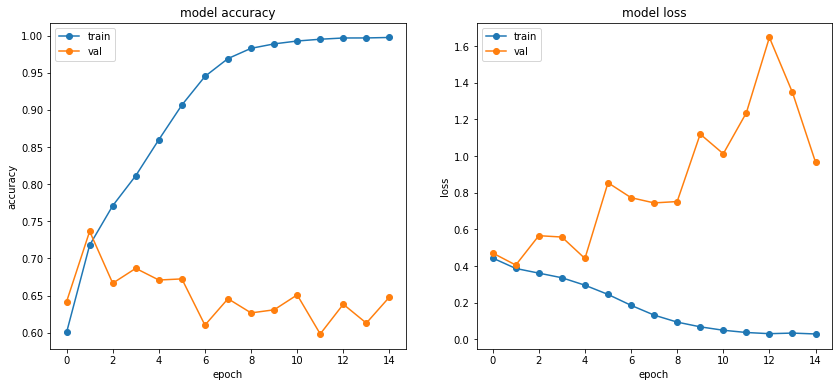

In [0]:
#https://machinelearningmastery.com/display-deep-learning-model-training-history-in-keras/
fig = plt.figure(figsize=(14,6))

# summarize history for accuracy
plt.subplot(1,2,1)
plt.title('model accuracy')
plt.plot(history1.history['aucroc'], marker='o')
plt.plot(history1.history['val_aucroc'], marker='o')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')

# summarize history for loss
plt.subplot(1,2,2)
plt.title('model loss')
plt.plot(history1.history['loss'], marker='o')
plt.plot(history1.history['val_loss'], marker='o')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

In [0]:
# from keras.models import Sequential, load_model
# # load the model
# prev_model = load_model("/content/Model1-weights-improvement-02-0.38.hdf5")
# #assert_allclose(model.predict(x_train), new_model.predict(x_train), 1e-5)

### Model-2

Use the same model as above but for 'input_seq_total_text_data' give only some words in the sentance not all the words. Filter the words as below. 

```
1. Train the TF-IDF on the Train data
2. Get the idf value for each word we have in the train data.
3. Remove the low idf value and high idf value words from our data. Do some analysis on the Idf values and based on those values choose the low and high threshold value. Because very frequent words and very very rare words don't give much information. (you can plot a box plots and take only the idf scores within IQR range and corresponding words)
4. Train the LSTM after removing the Low and High idf value words. (In model-1 Train on total data but in Model-2 train on data after removing some words based on IDF values)
```

#### TFIDF on essays

In [0]:
tfidf_vectorizer = TfidfVectorizer()
tfidf_vectorizer.fit(x_train['essay'])

tfidf_vectorizer.idf_.shape,  max(tfidf_vectorizer.idf_), min(tfidf_vectorizer.idf_)

((46053,), 11.397406052985405, 1.0077801142881022)

Text(0.5, 0, 'IDF scores')

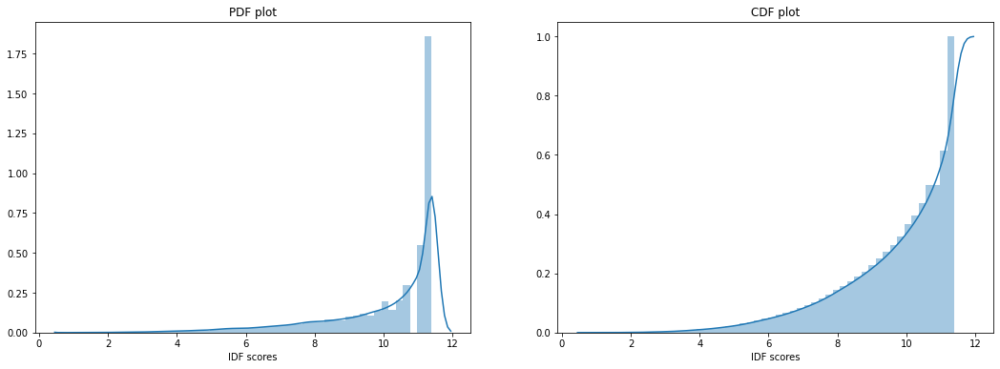

In [0]:
fig = plt.figure(figsize=(18,6))

# PDF plots
plt.subplot(1,2,1)
plt.title('PDF plot')
ax= sns.distplot(tfidf_vectorizer.idf_)
plt.xlabel('IDF scores')

# CDF plots
plt.subplot(1,2,2)
plt.title('CDF plot')
kwargs = {'cumulative': True}
ax= sns.distplot(tfidf_vectorizer.idf_, hist_kws=kwargs, kde_kws=kwargs)
plt.xlabel('IDF scores')

Text(0.5, 0, 'IDF scores')

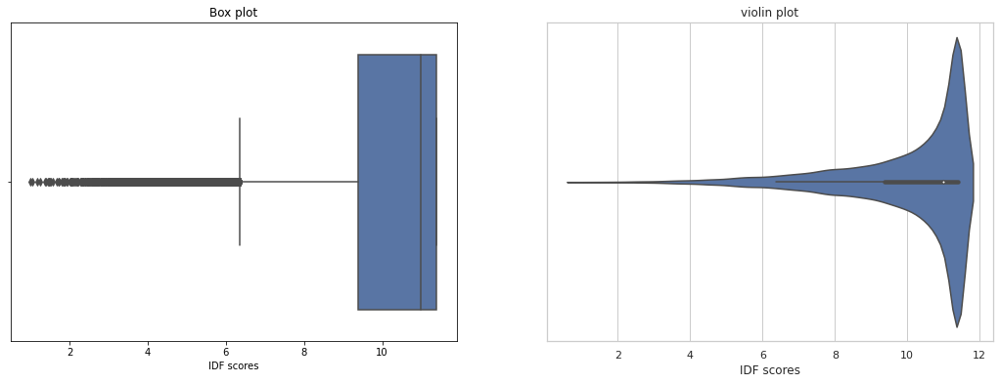

In [0]:
fig = plt.figure(figsize=(18,6))
# Box plot
plt.subplot(1,2,1)
plt.title('Box plot')
sns.set(style="whitegrid")
ax = sns.boxplot(tfidf_vectorizer.idf_)
plt.xlabel('IDF scores')

# Violin plot
plt.subplot(1,2,2)
plt.title('violin plot')
ax= sns.violinplot(tfidf_vectorizer.idf_)
plt.xlabel('IDF scores')

In [0]:
print("25th percentile : {0} ".format(np.percentile(tfidf_vectorizer.idf_, 25)))
print("75th percentile : {0} ".format(np.percentile(tfidf_vectorizer.idf_, 75)))

25th percentile : 9.38250303244314 
75th percentile : 11.397406052985405 


In [0]:
# Setting threshold as 4 - 11 
min_threshold = 4
max_threshold = 11
print("{0:.2f}% of words present with in {1} - {2} thresholds".format(
(100*len(list(filter(lambda x: x>min_threshold and x<max_threshold+0.01 , tfidf_vectorizer.idf_)))) / tfidf_vectorizer.idf_.shape[0],
 min_threshold, max_threshold))

60.39% of words present with in 4 - 11 thresholds


#### Filter essays with in threshld IDF range

In [0]:
idf_df = pd.DataFrame({"words": tfidf_vectorizer.get_feature_names() , "IDF":tfidf_vectorizer.idf_})
idf_df.sort_values(by=['IDF'], inplace=True)

# Filter dataframe with in threshold range 4 - 11 
idf_df = idf_df[(idf_df['IDF']>min_threshold-0.01) & (idf_df['IDF']<max_threshold+0.01) ]
idf_df

,words,IDF
14301,ensure,3.990695
7421,challenging,3.991606
14669,essential,3.991606
3660,at,3.993736
28350,number,3.994650
...,...,...
10404,cryptex,10.991941
24036,liberated,10.991941
7175,catholics,10.991941
6900,carb,10.991941


In [0]:
%%time
def remove_low_high_idf_words(essay):
    essay=essay.split()    
    return " ".join(list(filter(lambda x:x in idf_df["words"].values, essay)))

start_time = datetime.now()
x_train['filtered_essay'] = x_train["essay"].apply(remove_low_high_idf_words)   
print(".", end="")
x_val['filtered_essay'] = x_val["essay"].apply(remove_low_high_idf_words)
print(".", end="")
x_test["filtered_essay"] = x_test["essay"].apply(remove_low_high_idf_words)
print(".", end="")
print(datetime.now() - start_time)

...3:05:06.810914
CPU times: user 3h 5min 2s, sys: 16.5 s, total: 3h 5min 18s
Wall time: 3h 5min 6s


In [0]:
import pickle

pickle.dump(x_train['filtered_essay'],open(b"filtered_essay_train.pkl","wb"))
pickle.dump(x_val['filtered_essay'],open(b"filtered_essay_val.pkl","wb"))
pickle.dump(x_test['filtered_essay'],open(b"filtered_essay_test.pkl","wb"))


In [0]:
#load those pickle files
import pickle
x_train['filtered_essay'] = pickle.load(open(b"/content/filtered_essay_train.pkl","rb"))
x_val['filtered_essay'] = pickle.load(open(b"/content/filtered_essay_val.pkl","rb"))
x_test['filtered_essay'] = pickle.load(open(b"/content/filtered_essay_test.pkl","rb"))

In [0]:
# i=0
# print(x_train["essay"].iloc[i])
# remove_low_high_idf_words(x_train["essay"].iloc[i])
x_train.columns

Index(['school_state', 'teacher_prefix', 'project_grade_category',
       'teacher_number_of_previously_posted_projects', 'clean_categories',
       'clean_subcategories', 'essay', 'price', 'filtered_essay'],
      dtype='object')

#### Filtered essay Layer

In [0]:
"""
https://towardsdatascience.com/text-classification-in-keras-part-2-how-to-use-the-keras-tokenizer-word-representations-fd571674df23
https://machinelearningmastery.com/use-word-embedding-layers-deep-learning-keras/
"""
from keras.preprocessing.text import Tokenizer
#max_words = 10000
tokenizer = keras.preprocessing.text.Tokenizer( lower=True, split=' ', char_level=False, oov_token=None, document_count=0)
#tokenizer.fit_on_texts(idf_df["words"].values) 
# (or)
tokenizer.fit_on_texts(x_train["filtered_essay"].tolist()) #coz filtered_essay has the words that are id idf_df['words']

filtered_essay_sequences_train = tokenizer.texts_to_sequences(x_train['filtered_essay'])
filtered_essay_sequences_val = tokenizer.texts_to_sequences(x_val['filtered_essay'])
filtered_essay_sequences_test = tokenizer.texts_to_sequences(x_test['filtered_essay'])

#######################################################################

"""
https://keras.io/preprocessing/sequence/#pad_sequences
"""
from keras.preprocessing.sequence import pad_sequences
max_length=0;
for filtered_essay in x_train["filtered_essay"]:
    temp =len(filtered_essay)
    max_length= temp if temp > max_length else max_length

padded_filtered_essay_train = pad_sequences(filtered_essay_sequences_train, maxlen=max_length, dtype='int32', padding='post', truncating='post', value=0.0)
padded_filtered_essay_val = pad_sequences(filtered_essay_sequences_val, maxlen=max_length, dtype='int32', padding='post', truncating='post', value=0.0)
padded_filtered_essay_test = pad_sequences(filtered_essay_sequences_test, maxlen=max_length, dtype='int32', padding='post', truncating='post', value=0.0)

##### Loading Glove vectors

In [0]:
import pickle
with open("/content/drive/My Drive/LSTM Assignment/glove_vectors","rb") as file:
    embeddings = pickle.load(file)

# vocab_size + 1 since, 0 is not considered by tokenizer.
vocab_size = len(tokenizer.word_index)+1

# create a weight matrix for words in training docs
embedding_matrix = np.zeros((vocab_size, 300))

for word, i in tqdm(tokenizer.word_index.items()):
		embedding_vector = embeddings.get(word)
		if embedding_vector is not None:
				embedding_matrix[i] = embedding_vector

embedding_matrix.shape

100%|██████████| 27818/27818 [00:00<00:00, 215368.05it/s]


(27819, 300)

In [0]:
"""
https://stats.stackexchange.com/questions/270546/how-does-keras-embedding-layer-work
"""
from keras.engine.input_layer import Input
from keras.layers import Embedding, Flatten, LSTM, Dense
from keras.initializers import Constant

filtered_essay_input_layer = Input(shape=(max_length,), name="filtered_essay_i/p")#, batch_shape=(1000,max_length))
filtered_essay_embedding_layer = Embedding(vocab_size, 300, \
                                  embeddings_initializer=Constant(embedding_matrix),\
                                  input_length=max_length)(filtered_essay_input_layer)

filtered_essay_embedding_layer.trainable = False

filtered_essay_lstm_layer = LSTM(10, return_sequences=True)(filtered_essay_embedding_layer)
# https://github.com/keras-team/keras/issues/7403
filtered_essay_flatten = Flatten()(filtered_essay_lstm_layer)

In [0]:
max_length, filtered_essay_input_layer.shape , filtered_essay_embedding_layer.shape , filtered_essay_lstm_layer.shape , filtered_essay_flatten.shape

(1515,
 TensorShape([None, 1515]),
 TensorShape([None, 1515, 300]),
 TensorShape([None, 1515, 10]),
 TensorShape([None, None]))

In [0]:
from keras.layers import concatenate, Dropout, BatchNormalization
from keras.models import Model

concatenate_layer = concatenate([filtered_essay_flatten, school_state_flatten, grade_flatten, categories_flatten,
                     subcategories_flatten, teacher_prefix_flatten, numerical_dense])

In [0]:
dense_layer0 = Dense(64, activation="relu")(concatenate_layer)

BN_layer0 = BatchNormalization()(dense_layer0)

dropout_layer0 = Dropout(0.3)(BN_layer0)

dense_layer1 = Dense(32, activation="relu")(dropout_layer0)

BN_layer1 = BatchNormalization()(dense_layer1)

dropout_layer1 = Dropout(0.2)(dense_layer2)

dense_layer2 = Dense(16, activation="relu")(dropout_layer2)

final_layer = Dense(1, activation='sigmoid', name="o/p_layer")(dense_layer3)


In [0]:
model2= Model(inputs=[filtered_essay_input_layer, school_state_input_layer, teacher_prefix_input_layer, grade_input_layer,
                      categories_input_layer, subcategories_input_layer, numerical_input_layer], 
              outputs=[final_layer])

In [0]:
# https://stackoverflow.com/questions/41032551/how-to-compute-receiving-operating-characteristic-roc-and-auc-in-keras
import tensorflow as tf
from sklearn.metrics import roc_auc_score

def aucroc(y_true, y_pred):
    return tf.py_function(roc_auc_score, (y_true, y_pred), tf.double)

In [0]:
model2.compile(optimizer='adam', loss='binary_crossentropy', metrics = [aucroc]) 
model2.summary()

Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
filtered_essay_i/p (InputLayer) (None, 1515)         0                                            
__________________________________________________________________________________________________
embedding_7 (Embedding)         (None, 1515, 300)    8345700     filtered_essay_i/p[0][0]         
__________________________________________________________________________________________________
school_state (InputLayer)       (None, 1)            0                                            
__________________________________________________________________________________________________
grade_i/p (InputLayer)          (None, 1)            0                                            
____________________________________________________________________________________________

In [0]:
input_train = [  padded_filtered_essay_train, 
                 school_state_x_train,
                 grade_x_train,
                 teacher_prefix_x_train,
                 categories_x_train,
                 subcategories_x_train,
                 numerical_features_x_train,
                ]

input_val = [  padded_filtered_essay_val, 
              school_state_x_val,
              grade_x_val,
              teacher_prefix_x_val,
              categories_x_val,
              subcategories_x_val,
              numerical_features_x_val,
            ]

input_test = [  padded_filtered_essay_test, 
                school_state_x_test,
                grade_x_test,
                teacher_prefix_x_test,
                categories_x_test,
                subcategories_x_test,
                numerical_features_x_test,
                ]              

In [0]:
for i in input_train:
    print(i.shape)
    
y_train.shape, y_val.shape, y_test.shape

(65548, 1515)
(65548,)
(65548,)
(65548,)
(65548, 9)
(65548, 30)
(65548, 2)


((65548,), (21850,), (21850,))

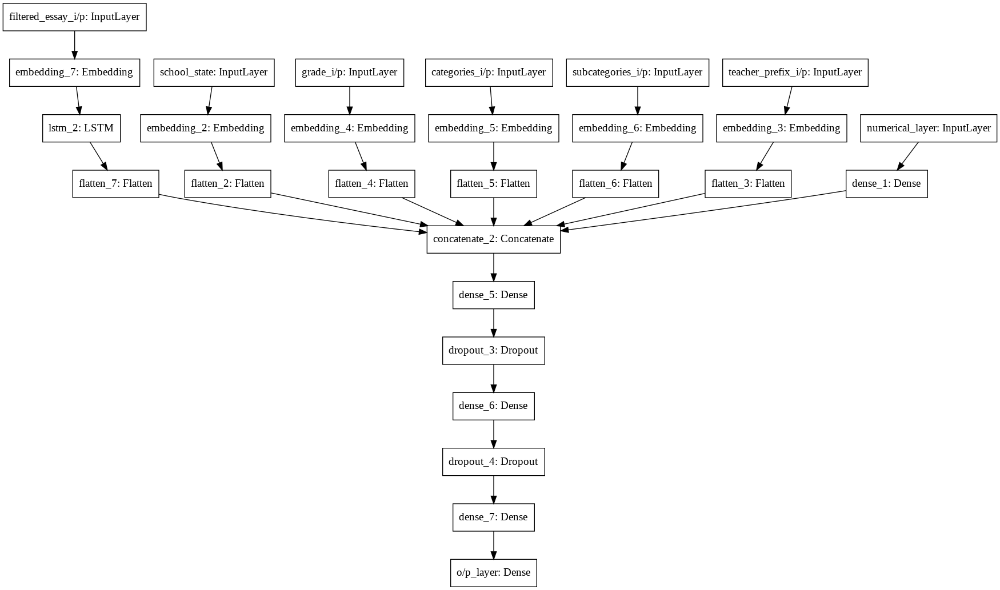

In [0]:
from keras.utils import plot_model
plot_model(model2, to_file='model2.png')

In [0]:
batch_size=400
epochs = 20

In [0]:
# https://keras.io/callbacks/

tensorboard_callback = TensorBoard(log_dir='./logs', histogram_freq=1, batch_size=batch_size, write_graph=True, 
                           write_grads=False, write_images=True, embeddings_freq=0, update_freq='epoch')

filepath="Model2-weights-improvement-{epoch:02d}-{val_loss:.2f}.hdf5"
# I'm saving only best weights among the all epochs
model_checkpoint_callback = ModelCheckpoint(filepath, monitor='val_loss', verbose=0, 
                                          save_best_only=True, save_weights_only=False, mode='auto', period=1)

In [0]:
%tensorboard --logdir logs

<IPython.core.display.Javascript object>

In [0]:
history2 = model2.fit(input_train, y_train ,batch_size=batch_size,
                        epochs=epochs, validation_data=(input_val, y_val),
                      callbacks=[tensorboard_callback, model_checkpoint_callback, early_stopping_callback])

Train on 65548 samples, validate on 21850 samples
Epoch 1/10
65548/65548 [==============================] - 467s 7ms/step - loss: 0.4213 - aucroc: 0.6377 - val_loss: 0.4015 - val_aucroc: 0.7182
Epoch 2/10
65548/65548 [==============================] - 462s 7ms/step - loss: 0.3794 - aucroc: 0.7448 - val_loss: 0.3882 - val_aucroc: 0.7205
Epoch 3/10
65548/65548 [==============================] - 466s 7ms/step - loss: 0.3483 - aucroc: 0.8031 - val_loss: 0.3942 - val_aucroc: 0.7083
Epoch 4/10
19600/65548 [=======>......................] - ETA: 5:15 - loss: 0.2961 - aucroc: 0.8695

KeyboardInterrupt: ignored

In [0]:
#https://machinelearningmastery.com/display-deep-learning-model-training-history-in-keras/
fig = plt.figure(figsize=(14,6))

# summarize history for accuracy
plt.subplot(1,2,1)
plt.title('model accuracy')
plt.plot(history2.history['aucroc'])
plt.plot(history2.history['val_aucroc'])
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')

# summarize history for loss
plt.subplot(1,2,2)
plt.title('model loss')
plt.plot(history2.history['loss'])
plt.plot(history2.history['val_loss'])
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

In [0]:
from keras.models import load_model
model2.save("model2.hd5")

### Model-3

<img src='https://i.imgur.com/fkQ8nGo.png'>
ref: https://i.imgur.com/fkQ8nGo.png


- __input_seq_total_text_data__: <br>
<pre>
    . Use text column('essay'), and use the Embedding layer to get word vectors. <br>
    . Use given predefined glove word vectors, don't train any word vectors. <br>
    . Use LSTM that is given above, get the LSTM output and Flatten that output. <br>
    . You are free to preprocess the input text as you needed. <br>
</pre>
- __Other_than_text_data__:<br>
<pre>
    . Convert all your Categorical values to onehot coded and then concatenate all these onehot vectors <br>
    . Neumerical values and use <a href='https://keras.io/getting-started/sequential-model-guide/#sequence-classification-with-1d-convolutions'>CNN1D</a> as shown in above figure. <br>
    . You are free to choose all CNN parameters like kernel sizes, stride.<br>
    
</pre>

#### input_seq_total_text_data:

##### essay

In [0]:
"""
https://towardsdatascience.com/text-classification-in-keras-part-2-how-to-use-the-keras-tokenizer-word-representations-fd571674df23
https://machinelearningmastery.com/use-word-embedding-layers-deep-learning-keras/
"""
from keras.preprocessing.text import Tokenizer
#max_words = 10000
tokenizer = keras.preprocessing.text.Tokenizer( lower=True, split=' ', char_level=False, oov_token=None, document_count=0)
tokenizer.fit_on_texts(x_train["essay"])

essay_sequences_train = tokenizer.texts_to_sequences(x_train['essay'])
essay_sequences_val = tokenizer.texts_to_sequences(x_val['essay'])
essay_sequences_test = tokenizer.texts_to_sequences(x_test['essay'])

#######################################################################

"""
https://keras.io/preprocessing/sequence/#pad_sequences
"""
from keras.preprocessing.sequence import pad_sequences
max_length=0;
for essay in x_train["essay"]:    
    temp =len(essay)
    max_length= temp if temp > max_length else max_length

padded_essay_train = pad_sequences(essay_sequences_train, maxlen=max_length, dtype='int32', padding='post', truncating='post', value=0.0)
padded_essay_val = pad_sequences(essay_sequences_val, maxlen=max_length, dtype='int32', padding='post', truncating='post', value=0.0)
padded_essay_test = pad_sequences(essay_sequences_test, maxlen=max_length, dtype='int32', padding='post', truncating='post', value=0.0)

In [39]:
import pickle
with open("/content/drive/My Drive/LSTM Assignment/glove_vectors","rb") as file:
    embeddings = pickle.load(file)

# vocab_size + 1 since, 0 is not considered by tokenizer.
vocab_size = len(tokenizer.word_index)+1

# create a weight matrix for words in training docs
embedding_matrix = np.zeros((vocab_size, 300))

for word, i in tqdm(tokenizer.word_index.items()):
		embedding_vector = embeddings.get(word)
		if embedding_vector is not None:
				embedding_matrix[i] = embedding_vector

embedding_matrix.shape

100%|██████████| 47291/47291 [00:00<00:00, 416583.35it/s]


(47292, 300)

In [0]:
"""
https://stats.stackexchange.com/questions/270546/how-does-keras-embedding-layer-work
"""
from keras.engine.input_layer import Input
from keras.layers import Embedding, Flatten, LSTM, Dense
from keras.initializers import Constant

essay_input_layer = Input(shape=(max_length,), name="essay_i/p")#, batch_shape=(1000,max_length))
essay_embedding_layer = Embedding(vocab_size, 300, \
                                  embeddings_initializer=Constant(embedding_matrix),\
                                  input_length=max_length)(essay_input_layer)
essay_embedding_layer.trainable=False
essay_lstm_layer = LSTM(10, return_sequences=True)(essay_embedding_layer)
# https://github.com/keras-team/keras/issues/7403
essay_flatten = Flatten()(essay_lstm_layer)

In [41]:
max_length, essay_input_layer.shape , essay_embedding_layer.shape , essay_lstm_layer.shape , essay_flatten.shape

(2527,
 TensorShape([None, 2527]),
 TensorShape([None, 2527, 300]),
 TensorShape([None, 2527, 10]),
 TensorShape([None, None]))

#### Other_than_text_data

#### OHE categorical_features

```
clean_categories have more than one value in each row, which is seperated by space.
So, LabelEncoding may cosider multiple values in a row as a unique token.
Therefore, use OneHotEncoding (or) Do tokenizer-sequences, padding and then pass it to Embedding Layer.
```

In [0]:
from sklearn.feature_extraction.text import CountVectorizer

def vectorize_cat_data(x_train, x_val, x_test, col_name): 
    #filling nan with NAN
    x_train[col_name] = x_train[col_name].fillna('NAN')
    x_val[col_name] = x_val[col_name].fillna('NAN')
    x_test[col_name] = x_test[col_name].fillna('NAN')
    
    vectorizer= CountVectorizer(binary=True)
    vectorizer.fit(x_train[col_name].values)

    col_name_one_hot = vectorizer.transform(x_train[col_name].values)
    # store the feature names of all categorical columns
    print(vectorizer.get_feature_names())
    print("Shape of matrix after one hot encoding ",col_name_one_hot.shape,"\n")

    return vectorizer , col_name_one_hot, vectorizer.transform(x_val[col_name].values), vectorizer.transform(x_test[col_name].values)


In [43]:
#OHE clean_categories
categories_vectorizer, categories_x_train, categories_x_val, categories_x_test = \
                                                    vectorize_cat_data(x_train, x_val, x_test, 'clean_categories') 
#OHE clean_subcategories
subcategories_vectorizer, subcategories_x_train, subcategories_x_val, subcategories_x_test = \
                                                    vectorize_cat_data(x_train, x_val, x_test, 'clean_subcategories')                                           
#OHE school_state
school_state_vectorizer, school_state_x_train, school_state_x_val, school_state_x_test = \
                                                    vectorize_cat_data(x_train, x_val, x_test, 'school_state')
#OHE teacher_prefix 
teacher_prefix_vectorizer, teacher_prefix_x_train, teacher_prefix_x_val, teacher_prefix_x_test = \
                                                    vectorize_cat_data(x_train, x_val, x_test, 'school_state')
#OHE project_grade_category
grade_vectorizer, grade_x_train, grade_prefix_x_val, grade_prefix_x_test = \
                                                    vectorize_cat_data(x_train, x_val, x_test, 'project_grade_category')
                                                    

['appliedlearning', 'care_hunger', 'health_sports', 'history_civics', 'literacy_language', 'math_science', 'music_arts', 'specialneeds', 'warmth']
Shape of matrix after one hot encoding  (69918, 9) 

['appliedsciences', 'care_hunger', 'charactereducation', 'civics_government', 'college_careerprep', 'communityservice', 'earlydevelopment', 'economics', 'environmentalscience', 'esl', 'extracurricular', 'financialliteracy', 'foreignlanguages', 'gym_fitness', 'health_lifescience', 'health_wellness', 'history_geography', 'literacy', 'literature_writing', 'mathematics', 'music', 'nutritioneducation', 'other', 'parentinvolvement', 'performingarts', 'socialsciences', 'specialneeds', 'teamsports', 'visualarts', 'warmth']
Shape of matrix after one hot encoding  (69918, 30) 

['ak', 'al', 'ar', 'az', 'ca', 'co', 'ct', 'dc', 'de', 'fl', 'ga', 'hi', 'ia', 'id', 'il', 'in', 'ks', 'ky', 'la', 'ma', 'md', 'me', 'mi', 'mn', 'mo', 'ms', 'mt', 'nc', 'nd', 'ne', 'nh', 'nj', 'nm', 'nv', 'ny', 'oh', 'ok', 'o

In [44]:
type(grade_x_train)

scipy.sparse.csr.csr_matrix

##### Numerical_features

In [0]:
# standardization sklearn: https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.StandardScaler.html

from sklearn.preprocessing import StandardScaler, Normalizer
from scipy import sparse
#This function return the normalized data.
def standardize_data(x_train, x_val, x_test, column):   
    scalar = StandardScaler()
    scalar.fit(x_train[column].values.reshape(-1,1))
    std_scalar_x_train = scalar.transform(x_train[column].values.reshape(-1,1))
    std_scalar_x_val = scalar.transform(x_val[column].values.reshape(-1,1))
    std_scalar_x_test = scalar.transform(x_test[column].values.reshape(-1,1))
    print(std_scalar_x_train.shape)
    return std_scalar_x_train, std_scalar_x_val, std_scalar_x_test
    #return sparse.csr_matrix(std_scalar_x_train), sparse.csr_matrix(std_scalar_x_val), sparse.csr_matrix(std_scalar_x_test)

In [46]:
price_x_train, price_x_val, price_x_test = \
                                        standardize_data(x_train, x_val, x_test, "price")

teacher_prev_projects_x_train, teacher_prev_projects_x_val, teacher_prev_projects_x_test = \
                                        standardize_data(x_train, x_val, x_test, "teacher_number_of_previously_posted_projects")

(69918, 1)
(69918, 1)


```
Now, stack all categorical OHE data and numerical data
```

In [0]:
from scipy.sparse import hstack
other_than_text_x_train = hstack((categories_x_train, subcategories_x_train, school_state_x_train, teacher_prefix_x_train, grade_x_train, price_x_train, teacher_prev_projects_x_train))

other_than_text_x_val = hstack((categories_x_val, subcategories_x_val, school_state_x_val, teacher_prefix_x_val, grade_prefix_x_val, price_x_val, teacher_prev_projects_x_val))

other_than_text_x_test = hstack((categories_x_test, subcategories_x_test, school_state_x_test, teacher_prefix_x_test, grade_prefix_x_test, price_x_test, teacher_prev_projects_x_test))


In [48]:
# these should be having 3 dimensions as we are using conv1D filters, 
# so change the dimension to 3D (Ex: (x,x,1) like this)
# https://stackoverflow.com/questions/17394882/how-can-i-add-new-dimensions-to-a-numpy-array

other_than_text_x_train = other_than_text_x_train.todense()[..., None]
other_than_text_x_val = other_than_text_x_val.todense()[..., None]
other_than_text_x_test = other_than_text_x_test.todense()[..., None]

print(other_than_text_x_train.shape , other_than_text_x_val.shape, other_than_text_x_test.shape)

(69918, 147, 1) (17480, 147, 1) (21850, 147, 1)


In [0]:
from keras.layers import Conv1D, Dropout

# https://stackoverflow.com/questions/49840968/valueerror-input-0-is-incompatible-with-layer-conv1d-1-expected-ndim-3-found
other_than_text_input_layer = Input(shape=(other_than_text_x_train.shape[1],1) , name="other_than_text_i/p")

conv1d_layer0 = Conv1D(filters=128, kernel_size=3, padding="valid", 
                       activation="relu", strides=1, kernel_initializer="he_normal")(other_than_text_input_layer)

conv1d_layer1 = Conv1D(filters=64, kernel_size=3, padding="valid", 
                       activation="relu", strides=1, kernel_initializer="he_normal")(conv1d_layer0)

flatten1 = Flatten()(conv1d_layer1)

concatenate_layer = concatenate([essay_flatten, flatten1])

dense_layer0 = Dense(128,activation="relu",kernel_initializer="he_normal")(concatenate_layer)

dropout_layer0 = Dropout(0.5)(dense_layer0)

dense_layer1 = Dense(64,activation="relu",kernel_initializer="he_normal")(dropout_layer0)

dropout_layer1 = Dropout(0.5)(dense_layer1)

dense_layer2 = Dense(32,activation="relu",kernel_initializer="he_normal")(dropout_layer1)

output_layer = Dense(1, activation='sigmoid', name='output')(dense_layer2)


In [62]:
from keras.models import Model
from keras.optimizers import Adam
model3= Model(inputs=[essay_input_layer, other_than_text_input_layer], 
              outputs=[output_layer])
adam_optimizer = Adam(learning_rate=0.005, beta_1=0.9, beta_2=0.999)
model3.compile(optimizer=adam_optimizer, loss='binary_crossentropy', metrics = [aucroc]) 

model3.summary()

Model: "model_4"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
essay_i/p (InputLayer)          (None, 2527)         0                                            
__________________________________________________________________________________________________
other_than_text_i/p (InputLayer (None, 147, 1)       0                                            
__________________________________________________________________________________________________
embedding_7 (Embedding)         (None, 2527, 300)    14187600    essay_i/p[0][0]                  
__________________________________________________________________________________________________
conv1d_1 (Conv1D)               (None, 145, 128)     512         other_than_text_i/p[0][0]        
____________________________________________________________________________________________

In [0]:
# https://stackoverflow.com/questions/41032551/how-to-compute-receiving-operating-characteristic-roc-and-auc-in-keras
import tensorflow as tf
from sklearn.metrics import roc_auc_score

def aucroc(y_true, y_pred):
    return tf.py_function(roc_auc_score, (y_true, y_pred), tf.double)

In [0]:
input_train = [ padded_essay_train, 
                other_than_text_x_train
              ]

input_val = [ padded_essay_val, 
              other_than_text_x_val
            ]

input_test = [ padded_essay_test, 
               other_than_text_x_test
             ]              

In [65]:
y_train.shape, y_val.shape, y_test.shape

((69918,), (17480,), (21850,))

In [0]:
#@title
# test_input_length = 10000

# input_train = [  np.array(padded_essay_train)[:test_input_length], 
#                  np.array(school_state_x_train)[:test_input_length],
#                  np.array(grade_x_train)[:test_input_length],
#                  np.array(teacher_prefix_x_train)[:test_input_length],
#                  np.array(categories_x_train)[:test_input_length],
#                  np.array(subcategories_x_train)[:test_input_length],
#                  np.array(numerical_features_x_train)[:test_input_length],
#                 ]


# input_cv = [  np.array(padded_essay_val)[:test_input_length], 
#                  np.array(school_state_x_val)[:test_input_length],
#                  np.array(grade_x_val)[:test_input_length],
#                  np.array(teacher_prefix_x_val)[:test_input_length],
#                  np.array(categories_x_val)[:test_input_length],
#                  np.array(subcategories_x_val)[:test_input_length],
#                  np.array(numerical_features_x_val)[:test_input_length],
#                 ]

# input_test = [  np.array(padded_essay_test)[:test_input_length], 
#                  np.array(school_state_x_test)[:test_input_length],
#                  np.array(grade_x_test)[:test_input_length],
#                  np.array(teacher_prefix_x_test)[:test_input_length],
#                  np.array(categories_x_test)[:test_input_length],
#                  np.array(subcategories_x_test)[:test_input_length],
#                  np.array(numerical_features_x_test)[:test_input_length],
#                 ]              

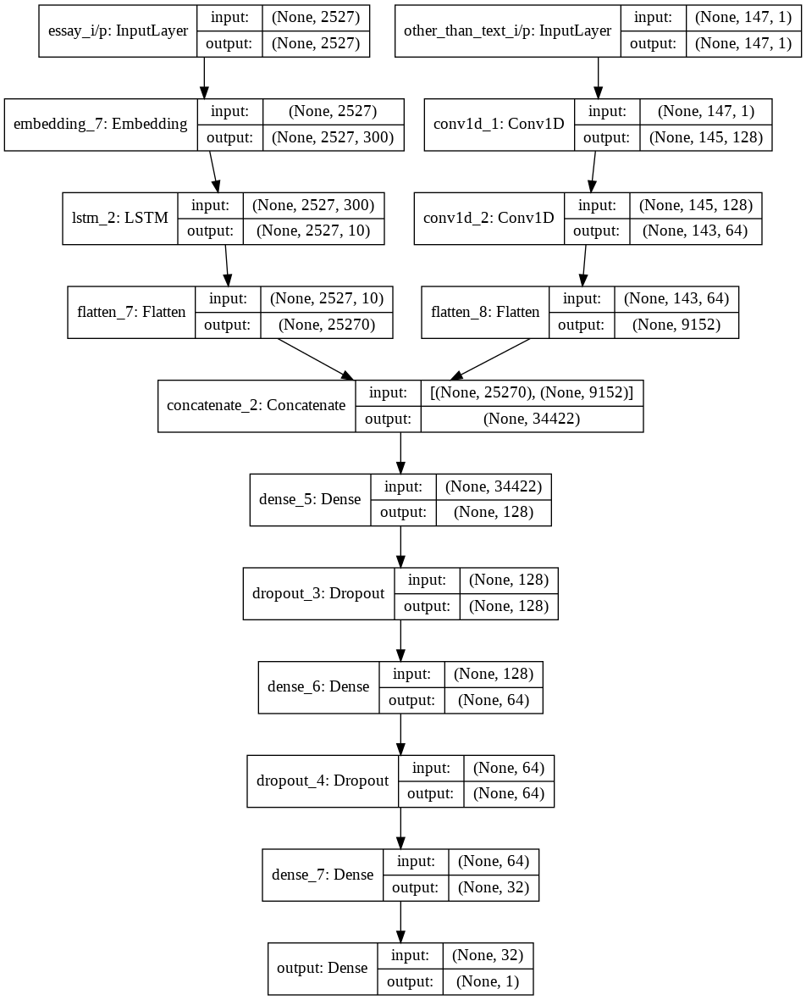

In [67]:
from keras.utils import plot_model
plot_model(model3, to_file='model3.png', show_shapes=True)

In [0]:
batch_size=400
epochs = 5

In [0]:
# https://keras.io/callbacks/
tensorboard_callback = TensorBoard(log_dir='./logs3', histogram_freq=1, batch_size=batch_size, write_graph=True, 
                           write_grads=False, write_images=True, embeddings_freq=0, update_freq='epoch')

filepath="Model3-weights-improvement-{epoch:02d}-{val_loss:.2f}.hdf5"
# I'm saving only best weights among the all epochs
model_checkpoint_callback = ModelCheckpoint(filepath, monitor='val_loss', verbose=0, 
                                          save_best_only=True, save_weights_only=False, mode='auto', period=1)

In [73]:
%tensorboard --logdir logs3

<IPython.core.display.Javascript object>

In [74]:
history3 = model3.fit(input_train, y_train ,batch_size=batch_size,
                        epochs=epochs, validation_data=(input_val, y_val),
                      callbacks=[tensorboard_callback, model_checkpoint_callback])

Train on 69918 samples, validate on 17480 samples
Epoch 1/5
69918/69918 [==============================] - 1650s 24ms/step - loss: 0.4653 - aucroc: 0.6276 - val_loss: 0.4160 - val_aucroc: 0.7531
Epoch 2/5
69918/69918 [==============================] - 1616s 23ms/step - loss: 0.3657 - aucroc: 0.7755 - val_loss: 0.4410 - val_aucroc: 0.7472
Epoch 3/5
69918/69918 [==============================] - 1606s 23ms/step - loss: 0.3234 - aucroc: 0.8410 - val_loss: 0.3957 - val_aucroc: 0.7304
Epoch 4/5
69918/69918 [==============================] - 1589s 23ms/step - loss: 0.2649 - aucroc: 0.9035 - val_loss: 0.4367 - val_aucroc: 0.7146
Epoch 5/5
30000/69918 [===========>..................] - ETA: 15:01 - loss: 0.1990 - aucroc: 0.9481

KeyboardInterrupt: ignored

### Conclusion:

In [79]:
from prettytable import PrettyTable

pt = PrettyTable(["model","train-auc", "test-auc", "train-loss", "test-loss"])
pt.add_row(["1", 0.7346, 0.7453, 0.3797, 0.3739])
pt.add_row(["2", 0.7448, 0.7205, 0.3794, 0.3882])
pt.add_row(["3", 0.7755, 0.7472, 0.3657, 0.4410])
print(pt)

+-------+-----------+----------+------------+-----------+
| model | train-auc | test-auc | train-loss | test-loss |
+-------+-----------+----------+------------+-----------+
|   1   |   0.7346  |  0.7453  |   0.3797   |   0.3739  |
|   2   |   0.7448  |  0.7205  |   0.3794   |   0.3882  |
|   3   |   0.7755  |  0.7472  |   0.3657   |   0.441   |
+-------+-----------+----------+------------+-----------+


In [0]:
"""
I tired running this in GoogleColab, which is getting disconnected ferquently.
Models are overfitting, but running it for more epochs I dont have good computational power.
Please Consider this limitation.
"""